In [538]:
from tqdm import tqdm
from glob import glob
from os.path import *
import os
from subprocess import *
import pandas as pd
from collections import defaultdict, Counter
import pandas as pd
from ete3 import Tree
from Bio import SeqIO


from dating_workflow.toolkit.mcmctree_for import *

In [824]:
os.chdir('/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/mcmc_o')
dataset_inlist = {'GS1': glob('./GS1_*_prot/mcmc_for/mcmc.txt'),
                  'GS1TP2': glob('./GS1TP2_*_prot/mcmc_for/mcmc.txt'),
                  'GS1TP3': glob('./GS1TP3_*_prot/mcmc_for/mcmc.txt'),
                  "GS2": glob('./GS2_*_prot/mcmc_for/mcmc.txt'),
                  "GS2TP2": glob('./GS2TP2_*_prot/mcmc_for/mcmc.txt'),
                  "GS2TP3": glob('./GS2TP3_*_prot/mcmc_for/mcmc.txt')}



key_nodes = {
    "GS1": {
        "t_n139": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n131": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n121": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n113": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n97": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n148": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n138": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1"),
    },

    "GS1TP2": {
        "t_n130": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n90": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n140": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n108": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n112": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n148": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n129": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1")
    },
    
    "GS1TP3": {
        "t_n139": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n122": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n128": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n113": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n96": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n148": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n138": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1")
    },


    "GS2": {
        "t_n162": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n145": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n151": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n135": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n120": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n196": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n161": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1"),
        "t_n171": ('Total eukaryota', "GCA_001870225.1|Cyanophora_paradoxa"), },

    "GS2TP2": {
        "t_n163": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n155": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n145": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n137": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n121": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n196": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n162": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1"),
        "t_n172": ('Total eukaryota', "GCA_001870225.1|Cyanophora_paradoxa"), },
     "GS2TP3": {
        "t_n163": ("Freshwater Syn", "GCA_002252705.1|GCA_903883435.1"),
        "t_n146": ("Nostocales", "GCA_014698965.1|GCA_002218085.1"),
        "t_n152": ("Okenia", "GCA_003838195.1|GCA_010672085.1"),
        "t_n137": ("Hydrococcus", "GCA_012034605.1|GCA_001904635.1"),
        "t_n120": ("UCYN", "GCA_003864315.1|GCA_013215395.1"),
        "t_n196": ("Pseudanabaena", "GCA_003249015.1|GCA_003456125.1"),
        "t_n162": ('marine syn/pro', "GCA_000586015.1|GCA_002252705.1"),
        "t_n172": ('Total eukaryota', "GCA_001870225.1|Cyanophora_paradoxa"), },

}


          



dataset_setting = {"GS1": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS1']),
                   "GS1TP2": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS1TP2']),
                   "GS1TP3": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS1TP3']),
                   "GS2": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS2']),
                   "GS2TP2": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS2TP2']),
                   "GS2TP3": (lambda x: '_'.join(x.split('/')[-3].split('_')[1:3]), key_nodes['GS2TP3']),
                   }

topology_dict = {"GS1": ("/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS1.newick",        3,),
    "GS1TP2": ("//mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS1_tp2.newick",        8,),
    "GS2": ("/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS2.newick",        3,),
    "GS2TP2": ("/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS2_tp2.newick",        3,),
    "GS2TP3": ("/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS2_tp3.newick",        3,),
    "GS1TP3": ('/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS1_tp3.newick', 3),
}

    

In [642]:


dataset_setting = {"GS1": (lambda x: x.split('/')[-3].split('_')[1], key_nodes['GS1']),
                   "GS1TP2": (lambda x: x.split('/')[-3].split('_prot')[0].replace('GS1TP2', ''), key_nodes['GS1']),
                   "GS2": (lambda x: x.split('/')[-3].split('_')[1], "t_n111"),
                   "GS2TP2": (lambda x: x.split('/')[-3].split('_prot')[0].replace('GS2TP2', ''), key_nodes['GS2TP2']),
                   "GS2TP3": (lambda x: x.split('/')[-3].split('_prot')[0].replace('GS2TP3', ''), key_nodes['GS2TP2']),
                   }

In [ ]:
# t = get_tre(dataset_inlist['GS2TP3'][0])
# t2 = Tree(topology_dict['GS2'][0],topology_dict['GS2'][1])
# for n,(name,lca) in key_nodes['GS2'].items():
#     n1 = t.get_common_ancestor(lca.split('|'))
#     n2 = t2.get_common_ancestor(lca.split('|'))
#     assert len(n2.get_leaf_names()) == len(n1.get_leaf_names())
#     print(f"t_n{n1.name}")
#     #print(len(n1.get_leaf_names()))

In [590]:
set_name='GS2TP3'
for mcmc in dataset_inlist[set_name]:
    mcmc = 
    figtree = mcmc.replace('mcmc.txt','FigTree.tre')
    new_tree = join(dirname(figtree),f"{set_name}_{dataset_setting[set_name][0](mcmc)}.newick")
    #print(new_tree)
    cmd = f"""python3 ~/script/evol_tk/dating_workflow/figtree2itol.py -i {topology_dict[set_name][0]} -i2 {figtree} -o {new_tree} -f {topology_dict[set_name][1]}; """
    os.system(cmd)

In [821]:
set_name='GS1TP3'
dataset_inlist[set_name]
mcmc = './GS1TP3_p10_B1_prot/mcmc_for/mcmc.txt'
figtree = mcmc.replace('mcmc.txt','FigTree.tre')
new_tree = join(dirname(figtree),f"{set_name}_{dataset_setting[set_name][0](mcmc)}.newick")
#print(new_tree)
cmd = f"""python3 ~/script/evol_tk/dating_workflow/figtree2itol.py -i {topology_dict[set_name][0]} -i2 {figtree} -o {new_tree} -f {topology_dict[set_name][1]}; """
os.system(cmd)

0

In [231]:
for set_name,mcmc_l in dataset_inlist.items():
    for mcmc in mcmc_l:
        figtree = mcmc.replace('mcmc.txt','FigTree.tre')
        new_tree = join(dirname(figtree),f"{set_name}_{dataset_setting[set_name][0](mcmc)}.newick")
        #print(new_tree)
        cmd = f"""python3 ~/script/evol_tk/dating_workflow/figtree2itol.py -i {topology_dict[set_name][0]} -i2 {figtree} -o {new_tree} -f {topology_dict[set_name][1]}; """
        #if not exists()
        #print(cmd)
        os.system(cmd)

In [184]:
tree_dict = {}
for name,mcmc_list in dataset_inlist.items():
    rename_f = dataset_setting[name][0]
    tre = get_tre(mcmc_list[0])
    tree_dict[name] = tre

# branch length

In [720]:
def read_phy(phy_file,names=[]):
    rows = [_ for _ in open(phy_file).read().split('\n') if _]
    _d = defaultdict(dict)
    idx = -1
    for row in rows:
        a,b = [_ for _ in row.split(' ') if _]
        try:
            NoGenome = int(a)
            Nosites = int(b)
            idx+=1
        except:
            genome = a
            seq = b
            if set(seq) == set('-'):
                continue
            _d[idx][genome] = seq
    if names:
        _d = {names[idx]:v for idx,v in _d.items()}
    return _d
def get_branches_dist(t,leaves=[]):
    tre = Tree(t)
    if leaves:
        tre.prune(leaves)
    dist = tre.get_farthest_leaf()[1]
    return dist,tre
def read_branches_dist(rst2,leaves=[]):
    contexts = [_ for _ in open(rst2).read().split('\n') if _]
    all_tre_texts = [idx for idx,_ in enumerate(contexts) if _ == contexts[0]]
    all_tre_texts = [contexts[idx+1] for idx in all_tre_texts]
    assert len(all_tre_texts) == 1
    dist,tre = get_branches_dist(all_tre_texts[0],leaves=leaves)
    return dist,tre

def read_partition(partition_file):
    rows = [_ for _ in open(partition_file).read().split('\n') if _]
    name2length = {}
    names = []
    for r in rows:
        vals = [_ for _ in r.split(' ') if _ not in [',','=','']]
        gene = vals[1]
        s,e = vals[-1].split('-'); s,e = int(s),int(e)
        length = (e-s)+1
        name2length[gene] = length
        names.append(gene)
    return names,name2length

def get_rates(indir,write_tree=''):
    target_dir = dirname(indir)+'/tmp_files'
    ctl = target_dir+'/01_mcmctree_modify.ctl'
    row = [_ for _ in open(ctl).read().split('\n') if _.startswith('seqfile = ')][0]
    phy_file = row.strip().split(' ')[-1]
    partition_file = phy_file.replace('.phy','.partition')
    genes,name2length = read_partition(partition_file)
    gene2genome2seq = read_phy(phy_file,genes)
    _gene2rates = {}
    _gene2s = {}
    for _ in glob(f"{target_dir}/tmp*/rst1"):
        name = _.split('/')[-2]
        ns,sites,patterns = [_ for _ in open(_).read().strip().split('\t') if _][:3]
        gene = genes[int(name.replace('tmp',''))-1]
        _gene2s[gene] = (ns,sites,patterns)
        dist,tre = read_branches_dist(_[:-1]+'2',list(gene2genome2seq[gene]))
        _gene2rates[gene] = dist
        if write_tree:
            tre.write(outfile=write_tree+f"/{gene}.newick")
    return _gene2s,_gene2rates

In [721]:
set2dist = {}
for mcmc in dataset_inlist['GS2TP3']:
    indir = dirname(mcmc)
    try:
        name2s,name2rates = get_rates(indir)
    except:
        pass
    set2dist[dataset_setting['GS2TP3'][0](mcmc)] = name2rates

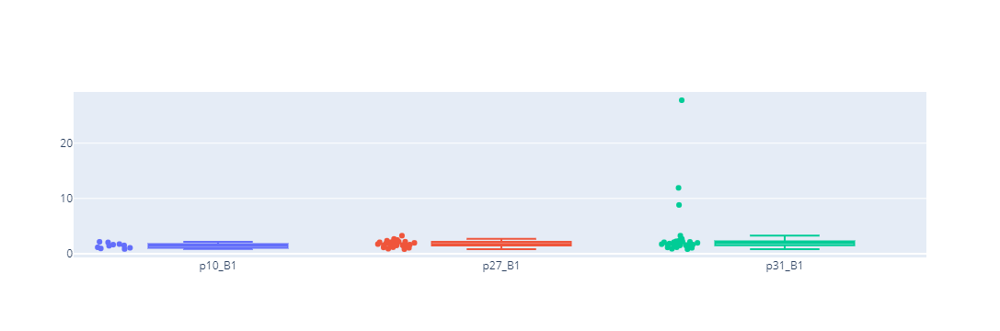

In [727]:

fig = go.Figure()
for name in ['p10_B1','p27_B1','p31_B1']:
    a = set2dist[name]
    fig.add_box(y=list(a.values()), # remove the first that is the time estimates
                name=name,
                       text = list(a.keys()),
                showlegend=False,
                boxpoints='all')
fig.layout.height = 300
fig.layout.width = 700
fig.show()

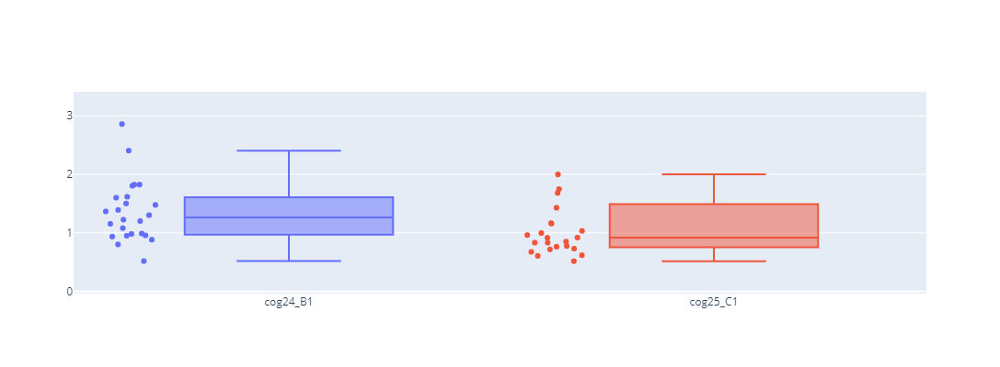

In [694]:
# set2dist = {}
# for mcmc in dataset_inlist['GS1']:
#     indir = dirname(mcmc)
#     try:
#         name2s,name2rates = get_rates(indir)
#         set2dist[dataset_setting['GS1'][0](mcmc)] = name2rates
#     except:
#         pass
fig = go.Figure()

for name in ['cog24_B1','cog25_C1']:
    a = set2dist[name]
# for name,a in set2dist.items():
    fig.add_box(y=list(a.values()), # remove the first that is the time estimates
                name=name,
                       text = list(a.keys()),
                showlegend=False,
                boxpoints='all')
fig.layout.height = 400
fig.layout.width = 600
fig.show()

In [345]:
remained_genes = [_[0] for _ in sorted(set2dist['p31_B1'].items(),key=lambda x:x[1]) if _[1] <=5]
with open('./GS1_p31_B1_prot/rates_st5.txt','w') as f1:
    f1.write('\n'.join(remained_genes))

# time estimates

In [ ]:
# result_df_CI = {}
# result_df = {}
# result_mcmc = {}

for name,mcmc_list in dataset_inlist.items():
    rename_f = dataset_setting[name][0]
    target_n = dataset_setting[name][1]
    
    new_names = [rename_f(_) for _ in mcmc_list]
    new_mcmc_l = [mcmc for mcmc,n in zip(mcmc_list,new_names) if n not in result_df[name]]
    post_dfdict, post_CIs_dict = read_multi_mcmc(mcmc_list, rename_f=rename_f)
    #dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
    dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
    _df = pd.concat(dfs,axis=1)
    _df.index = [target_n[_][0] for _ in _df.index]
    result_df[name] = _df
    result_df_CI[name] = post_CIs_dict
    result_mcmc[name] = {k:_df.loc[:,target_n] for k,_df in post_dfdict.items()}

In [825]:
name = 'GS1TP3';mcmc_list = dataset_inlist[name]
rename_f = dataset_setting[name][0]
target_n = dataset_setting[name][1]

#new_names = [rename_f(_) for _ in mcmc_list]
#if new_names:
    #new_mcmc_l = [mcmc for mcmc,n in zip(mcmc_list,new_names) if n not in result_df[name]]
post_dfdict, post_CIs_dict = read_multi_mcmc(mcmc_list, rename_f=rename_f)
#dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
_df = pd.concat(dfs,axis=1)
_df.index = [target_n[_][0] for _ in _df.index]
result_df_CI[name].update(post_CIs_dict)
result_mcmc[name].update({k:_df.loc[:,target_n] for k,_df in post_dfdict.items()})

100%|██████████| 18/18 [00:36<00:00,  2.04s/it]


In [652]:
for name in set(dataset_setting).difference(set(result_mcmc.keys())):
    mcmc_list = dataset_inlist[name]
    if not mcmc_list:continue
    rename_f = dataset_setting[name][0]
    target_n = dataset_setting[name][1]
    post_dfdict, post_CIs_dict = read_multi_mcmc(mcmc_list, rename_f=rename_f)
    #dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
    dfs = {k:v.loc[target_n,:] for k,v in post_CIs_dict.items()}
    _df = pd.concat(dfs,axis=1)
    _df.index = [target_n[_][0] for _ in _df.index]
    result_df[name] = _df
    result_df_CI[name] = post_CIs_dict
    result_mcmc[name] = {k:_df.loc[:,target_n] for k,_df in post_dfdict.items()}

100%|██████████| 15/15 [01:49<00:00,  7.30s/it]


## compare 

In [660]:
def _tmp_getdata(mcmcdf,target_n,fig):
    col = mcmcdf[[k for k,v in key_nodes[set_name].items() if v[0] == target_n][0]]
    fig.add_trace(go.Box(y=col*100,
                         name=f"{set_name};{scheme}",
                         #line_color = set2color[set_name],
                         showlegend=False,
                         legendgroup=set_name,
                         
                         marker={'color':geneset2color[scheme.split('_')[0]] if scheme.split('_')[0] in geneset2color else '#000000' } ,
                         boxpoints=False))
    
from IPython.display import Image
geneset2color = {'p31':"#0D47A1",
                 'p27':"#0091EA",
                 "p10":"#80D8FF",
                'cog24':"#ff0000"}

## GS1TP3 and GS2TP3

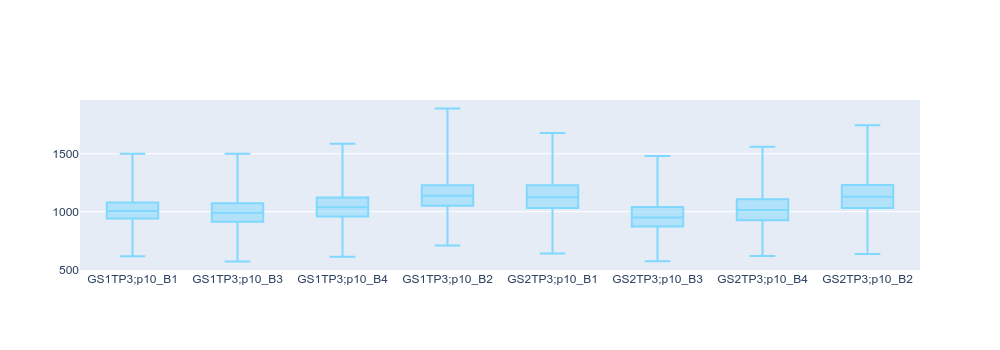

In [820]:
target_n = 'marine syn/pro'
#target_n = 'UCYN'
fig=go.Figure()

for scheme in [f'p10_B{z}' for z in '1342']:
    for set_name in ['GS1TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
for scheme in [f'p10_B{z}' for z in '1342']:
    for set_name in ['GS2TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 1000
fig.layout.height = 350
img = fig.to_image()
display(Image(img))

## GS1 different genes

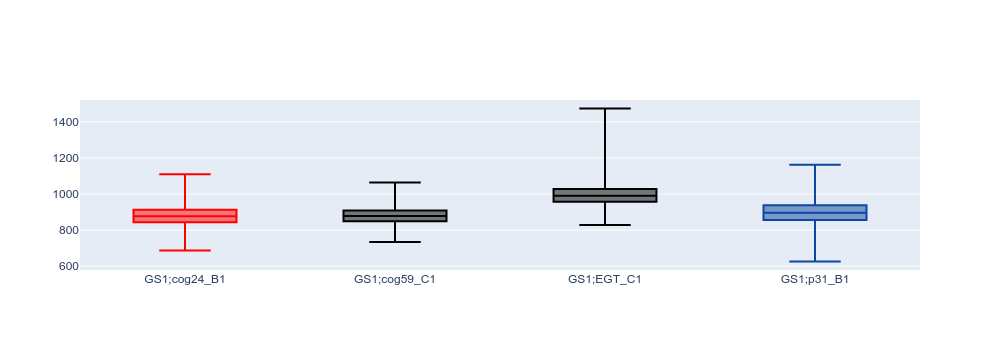

In [714]:
target_n = 'marine syn/pro'

fig=go.Figure()

for scheme in ['cog24_B1','cog59_C1','EGT_C1','p31_B1']:
    for set_name in ['GS1']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 1000
fig.layout.height = 350
img = fig.to_image()
display(Image(img))

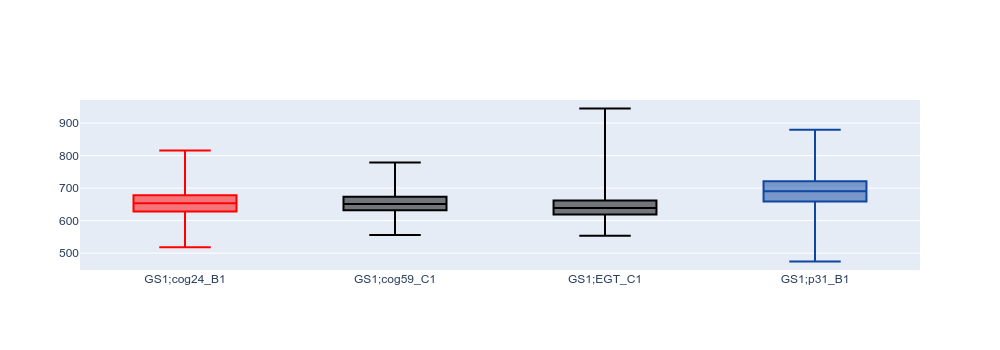

In [715]:
target_n = 'UCYN'

fig=go.Figure()

for scheme in ['cog24_B1','cog59_C1','EGT_C1','p31_B1']:
    for set_name in ['GS1']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 1000
fig.layout.height = 350
img = fig.to_image()
display(Image(img))

## GS1 TP3

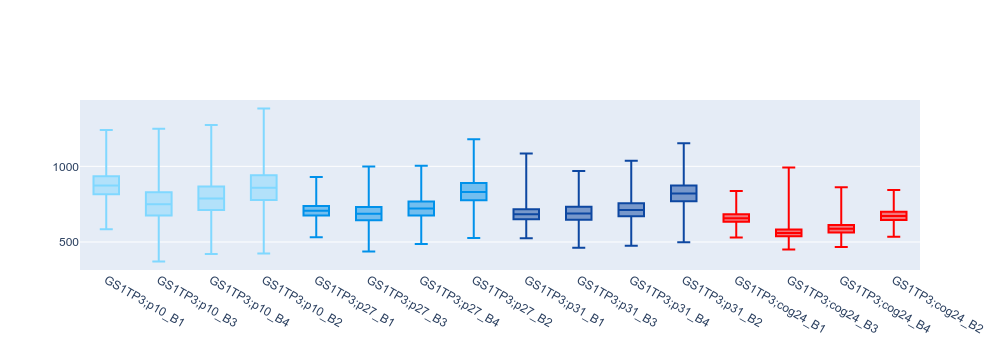

In [828]:
target_n = 'marine syn/pro'
target_n = 'UCYN'
fig=go.Figure()
for scheme in  [f'p{i}_B{z}' for i in ['10','27','31'] for z in '1342'] + ['cog24_B1','cog24_B3','cog24_B4','cog24_B2']:
    for set_name in ['GS1TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
# for scheme in ['cog24_B1','cog59_C1','EGT_C1','p31_B1']:
#     for set_name in ['GS1']:
#         #for scheme,mcmcdf in result_mcmc[set_name].items():
#         mcmcdf = result_mcmc[set_name][scheme]
#         _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 1000
fig.layout.height = 350
img = fig.to_image()
display(Image(img))

## GS2 TP3 (different calibrations)

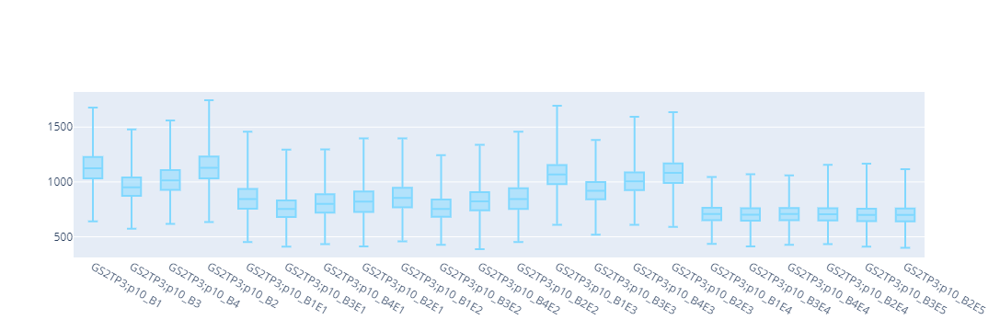

In [823]:
target_n = 'marine syn/pro'
#target_n = 'UCYN'
fig=go.Figure()

for scheme in [f'p10_B{z}' for z in '1342'] + [f'p10_B{z}E{i}'  for i in '1234' for z in '1342']+ [f'p10_B3E5',f'p10_B2E5'  ]:
    for set_name in ['GS2TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
# for scheme in [f'p10_B1E{i}' for i in '1234'] + [f'p10_B2E{i}' for i in '1234'] :
#     for set_name in ['GS2TP3']:
#         #for scheme,mcmcdf in result_mcmc[set_name].items():
#         mcmcdf = result_mcmc[set_name][scheme]
#         _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 900
fig.layout.height = 350
fig.show()

## GS2

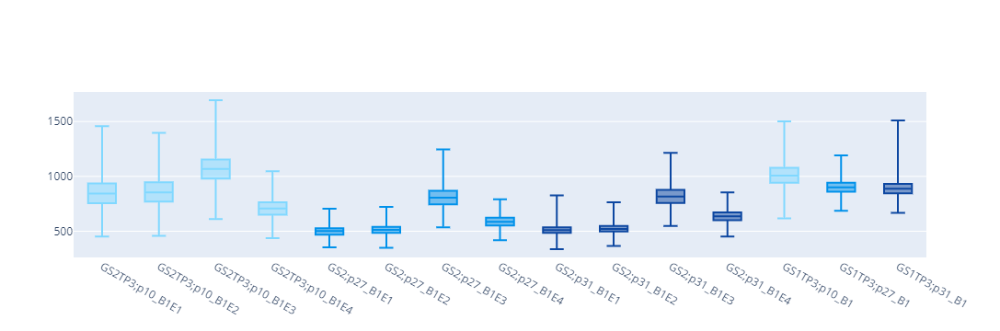

In [822]:
target_n = 'marine syn/pro'
#target_n = 'Okenia'
fig=go.Figure()

for scheme in [f'p10_B{z}E{i}' for i in '1234' for z in '1' ] :
    for set_name in ['GS2TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
        
for scheme in [f'p27_B{z}E{i}' for i in '1234' for z in '1' ] + [f'p31_B{z}E{i}' for i in '1234' for z in '1' ]:
    for set_name in ['GS2']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
        
for scheme in [f'p10_B1','p27_B1','p31_B1']:
    for set_name in ['GS1TP3']:
        #for scheme,mcmcdf in result_mcmc[set_name].items():
        mcmcdf = result_mcmc[set_name][scheme]
        _tmp_getdata(mcmcdf,target_n,fig)
# for scheme in [f'p10_B1E{i}' for i in '1234'] + [f'p10_B2E{i}' for i in '1234'] :
#     for set_name in ['GS2TP3']:
#         #for scheme,mcmcdf in result_mcmc[set_name].items():
#         mcmcdf = result_mcmc[set_name][scheme]
#         _tmp_getdata(mcmcdf,target_n,fig)
fig.layout.width = 1000
fig.layout.height = 350
fig.show()

# rate comparison

In [64]:
import plotly.graph_objects as go

In [451]:
rates_output = defaultdict(dict)
for set_name,mcmc_list in tqdm(dataset_inlist.items()):
    for mcmc in mcmc_list:
        indir = dirname(mcmc)
        log_file = mcmc.replace('mcmc.txt','03_mcmctree.log')
        if not exists(log_file):
            continue
        _df = read_result_CI(log_file)
        if _df is None:
            continue
        _df = _df.set_index('Name')
        _df = _df.reindex([_ for _ in _df.index if _.startswith("r_g")])
        rename_f = dataset_setting[set_name][0]
        rates_output[set_name][rename_f(mcmc)] = _df
for s,v in rates_output.items():
    print(s,list(v))

 60%|██████    | 3/5 [00:00<00:00,  6.66it/s]

./GS1TP2_EGT_B1_prot/mcmc_for/03_mcmctree.log doesn't finished
./GS2_p27_B1E4_prot/mcmc_for/03_mcmctree.log doesn't finished


100%|██████████| 5/5 [00:00<00:00,  9.22it/s]

GS1 ['p31_B1', 'cog24_C1', 'EGT_C1', 'p27_B1', 'cog59_C1', 'cog25_C1']
GS1TP2 ['p31_B1', 'p27_B1', 'cog24_B1']
GS1TP3 ['p27_B1', 'p31_B1']
GS2 ['p27_B1E1', 'p27_B1E2', 'p31_B1E3', 'p31_B1E2', 'p31_B1E1', 'p27_B1E3']
GS2TP2 ['p36_B2E3']


In [445]:
def get_rate_figdata(key1,key2,target_node):
    all_outs = []
    _d = rates_output[key1]
    for k2 in key2:
        df = _d[k2]
        cal = f"{set_name};{k2}"
        index_list = [_ for _ in df.index if f"t_{_.split('_')[-1]}" == target_node]
        sub_df = df.loc[index_list]
        fig_data = go.Box(y=sub_df.iloc[1:,0], # remove the first that is the time estimates
                name=cal,
                marker={'color':set2color.get(set_name,'#E65100')},
                showlegend=False,
                boxpoints='all')
        all_outs.append(fig_data)
    return all_outs

In [442]:
      
set2color = {'cog25':"#72daa4",
             'mito6_with_cyano':"#FF9800",
             'mito24_with_cyano':"#E65100",
             'mito6_no_euk':"#03A9F4",
             'mito24_no_euk':"#01579B",
              'mito6_no_cyano':"#FF9800",}
def get_f(set_names,target_node):
    fig=go.Figure()
    for set_name in set_names:
        _d = rates_output[set_name]
        for cal in _d:
            df = _d[cal]
            cal = f"{set_name};{cal}"
            #target_nodes = list(dataset_setting[set_name][1].keys())
            index_list = [_ for _ in df.index if f"t_{_.split('_')[-1]}" == target_node]
            sub_df = df.loc[index_list]
            fig.add_box(y=sub_df.iloc[1:,0], # remove the first that is the time estimates
                        name=cal,
                        marker={'color':set2color.get(set_name,'#E65100')},
                        showlegend=False,
                        boxpoints='all')
    fig.layout.width = 1000
    fig.layout.height = 500
    return fig
    #fig.show()

In [ ]:
target_n = 'marine syn/pro'

all_datas = get_rate_figdata('GS1',['p27_B1'],
                 [k for k,v in key_nodes['GS1'].items() if v[0] == target_n][0])
fig = go.Figure()
fig.add_traces(all_datas)
fig.show()

In [449]:
target_n = 'marine syn/pro'

scheme = 'p27_B1'
fig=go.Figure()
d = []
for set_name in ['GS1','GS1TP2','GS1TP3']:
    all_datas = get_rate_figdata(set_name,[scheme],
                 [k for k,v in key_nodes[set_name].items() if v[0] == target_n][0])
    d.extend(all_datas)
    
scheme = 'p31_B1'
for set_name in ['GS1TP2','GS1TP3']:
    all_datas = get_rate_figdata(set_name,[scheme],
                 [k for k,v in key_nodes[set_name].items() if v[0] == target_n][0])
    d.extend(all_datas)
    
for scheme in [f'p27_B1E{i}' for i in '123']:
    for set_name in ['GS2']:
        all_datas = get_rate_figdata(set_name,[scheme],
                     [k for k,v in key_nodes[set_name].items() if v[0] == target_n][0])
        d.extend(all_datas)  
for scheme in [f'p31_B1E{i}' for i in '123']:
    for set_name in ['GS2']:
        all_datas = get_rate_figdata(set_name,[scheme],
                     [k for k,v in key_nodes[set_name].items() if v[0] == target_n][0])
        d.extend(all_datas)  

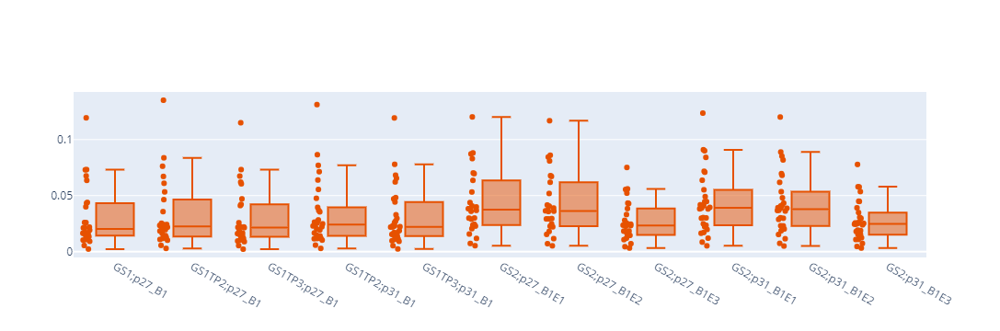

In [450]:
fig = go.Figure()
fig.add_traces(d)
fig.show()

## p31 to p10

In [483]:
def get_innodes(c):
    return [f"t_n{n.name}" for n in c.traverse() if not n.is_leaf()]


In [ ]:
name2s,name2rates = get_rates('./GS2_p27_B1E1_prot/')
name2rates

In [ ]:
from scipy.stats import mannwhitneyu
t = get_tre('./GS2_p27_B1E1_prot/mcmc_for/mcmc.txt')
name2node = {f"t_n{_.name}":_ for _ in t.traverse() }
c1,c2 = name2node['t_n108'].children
leaves1,leaves2 = get_innodes(c1),get_innodes(c2)

leaves1 = set(get_innodes(t)).difference(set(leaves2))
leaves1 = list(leaves1)
leaves1.remove('t_n104')
gene2pvalue = {}
for gene,num_gene in zip(name2s,range(27)):
    rate_df = rates_output['GS2']['p27_B1E1']
    num_gene +=1
    rate_df = rate_df.reindex(index=[_ for _ in rate_df.index if _.startswith(f'r_g{num_gene}_')])
    rate_df.index = [n.replace(f'r_g{num_gene}','t') for n in rate_df.index]
    df1,df2 = rate_df.loc[leaves1,:],rate_df.loc[leaves2,:]
    p = mannwhitneyu(df1["Posterior means"],df2["Posterior means"])
    gene2pvalue[gene] = p.pvalue
    if p.pvalue>=0.05:
        continue
    fig = go.Figure()
    fig.add_box(x=['bac']*df1.shape[0],y=df1.iloc[:,0],boxpoints='all',text=df1.index,showlegend=False)
    fig.add_box(x=['euk']*df2.shape[0],y=df2.iloc[:,0],boxpoints='all',text=df2.index,showlegend=False)
    fig.layout.height = 500
    fig.layout.width = 700
    img = fig.to_image()
    display(Image(img))
    #fig.show()

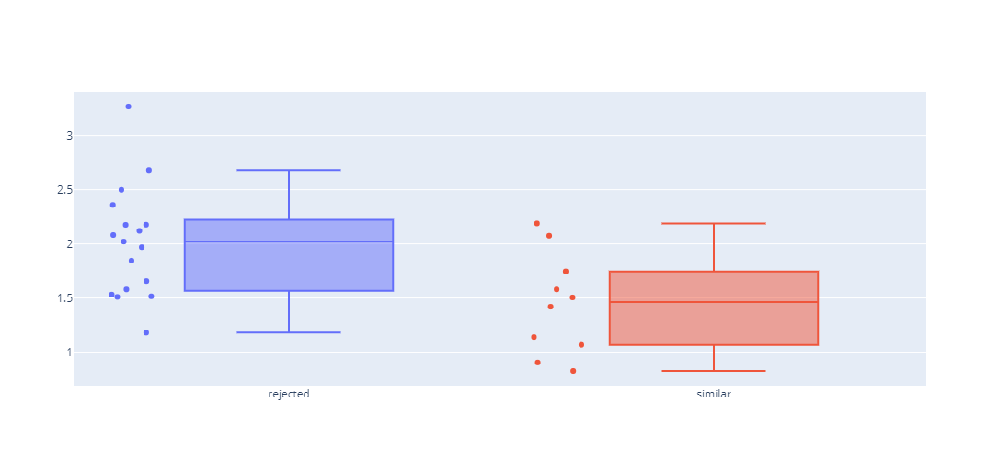

1.179791
1.509909
2.680848
2.1760009999999994
1.844344
2.3584739999999997
2.021126
1.969238
1.515244
1.5312270000000003
1.6561139999999999
2.1745229999999998
2.0811479999999998
2.4984889999999997
3.268178
2.119624
1.5787299999999997


In [518]:
fig = go.Figure()
rejected = [k for k,v in gene2pvalue.items() if v<=0.05]
fig.add_box(x=['rejected']*len(rejected),
            y=[name2rates[_] for _ in rejected],
            boxpoints='all',text=df1.index,showlegend=False)
not_rejected = [k for k,v in gene2pvalue.items() if v> 0.05]
fig.add_box(x=['similar']*len(rejected),
            y=[name2rates[_] for _ in not_rejected],
            boxpoints='all',text=df1.index,showlegend=False)

fig.layout.height = 500
fig.layout.width = 700
fig.show()
for gene in [k for k,v in gene2pvalue.items() if v<=0.05]:
    print(name2rates[gene])

In [516]:
left_genes = [k for k,v in gene2pvalue.items() if v>0.05]
with open('./GS2_p27_B1E1_prot/remaining_genes10.txt','w') as f1:
    f1.write('\n'.join(left_genes))

## compare rate between different calibrations

In [757]:
rates_output = defaultdict(dict)
for set_name,mcmc_list in tqdm(dataset_inlist.items()):
    for mcmc in mcmc_list:
        indir = dirname(mcmc)
        log_file = mcmc.replace('mcmc.txt','03_mcmctree.log')
        if not exists(log_file):
            continue
        _df = read_result_CI(log_file)
        if _df is None:
            continue
        _df = _df.set_index('Name')
        _df = _df.reindex([_ for _ in _df.index if _.startswith("r_g")])
        rename_f = dataset_setting[set_name][0]
        rates_output[set_name][rename_f(mcmc)] = _df
for s,v in rates_output.items():
    print(s,list(v))

'/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/mcmc_o'

In [761]:
def for_rate_df(log_file):
    _df = read_result_CI(log_file)
    _df = _df.set_index('Name')
    _df = _df.reindex([_ for _ in _df.index if _.startswith("r_g")])
    return _df

In [783]:
l1 = './GS2TP3_p10_B3_prot/mcmc_for/03_mcmctree.log'
l2 = './GS2TP3_p10_B3E2_prot/mcmc_for/03_mcmctree.log'

r1 = for_rate_df(l1)
r2 = for_rate_df(l2)

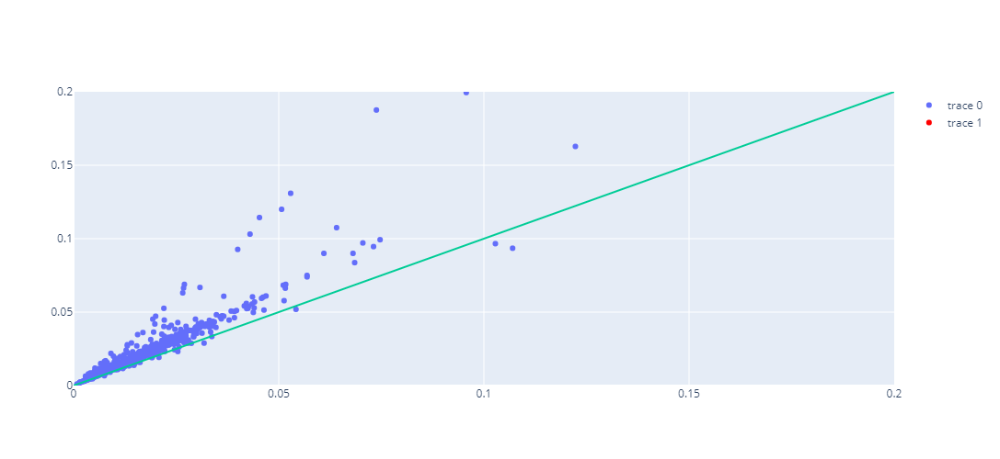

In [784]:

fig = go.Figure()
target1 = r1
target2 = r2
if target1.shape[0] == target2.shape[0]:
    fig.add_scatter(x=target1.iloc[:-1,0],y=target2.iloc[:-1,0],mode='markers')
    target_n = '_n163'
    t1 = [_ for _ in target1.index if _.startswith('r_g') and _.endswith(target_n)]
    fig.add_scatter(x=[target1.loc[t1,'Posterior means']],
                    y=[target2.loc[t1,'Posterior means']],
                    mode='markers',marker={'color':"#ff0000"})
c = 0.2
fig.add_scatter(x=[0,c],y=[0,c],mode='lines',showlegend=False)
fig.layout.xaxis.range = [0,c]
fig.layout.yaxis.range = [0,c]
fig.layout.width = 500
fig.layout.height = 500
fig.show()

In [804]:
def get_innodes(c):
    return [f"t_n{n.name}" for n in c.traverse() if not n.is_leaf()]

t = get_tre('./GS2TP3_p10_B1E1_prot/mcmc_for/mcmc.txt')
name2node = {f"t_n{_.name}":_ for _ in t.traverse() }
c1,c2 = name2node['t_n172'].up.children
bac_branch,euk_branch = get_innodes(c1),get_innodes(c2)

bac_branch = set(get_innodes(t)).difference(set(euk_branch))
bac_branch = list(bac_branch)
bac_branch.remove('t_n104')
l1 = './GS2TP3_p10_B3_prot/mcmc_for/03_mcmctree.log'
l2 = './GS2TP3_p10_B3E2_prot/mcmc_for/03_mcmctree.log'

r1 = for_rate_df(l1)
r2 = for_rate_df(l2)

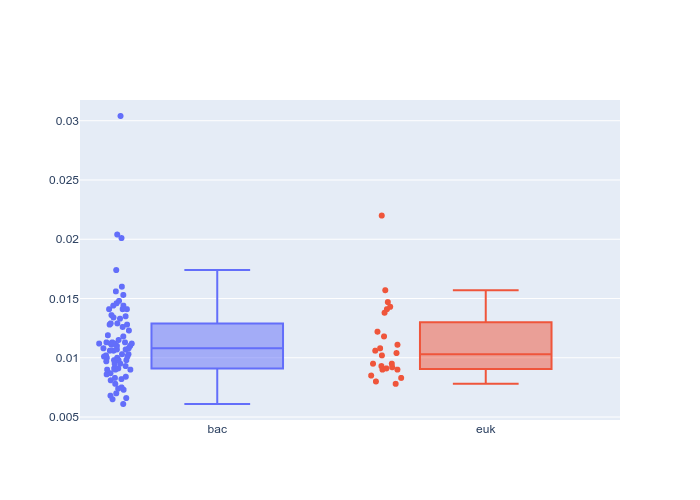

In [809]:
for i in range(1,11):
    bac_names = [f"r_g{i}_n{b.split('n')[-1]}" for b in bac_branch]
    euk_names = [f"r_g{i}_n{b.split('n')[-1]}" for b in euk_branch]
    
    fig = go.Figure()
    fig.add_box(x=['bac']*len(bac_names),
                y=r2.loc[bac_names,'Posterior means'],
                boxpoints='all',text=bac_names,showlegend=False)
    fig.add_box(x=['euk']*len(euk_names),
                y=r2.loc[euk_names,'Posterior means'],
                boxpoints='all',text=euk_names,showlegend=False)
    fig.layout.height = 500
    fig.layout.width = 700
    img = fig.to_image()
    display(Image(img))
    break

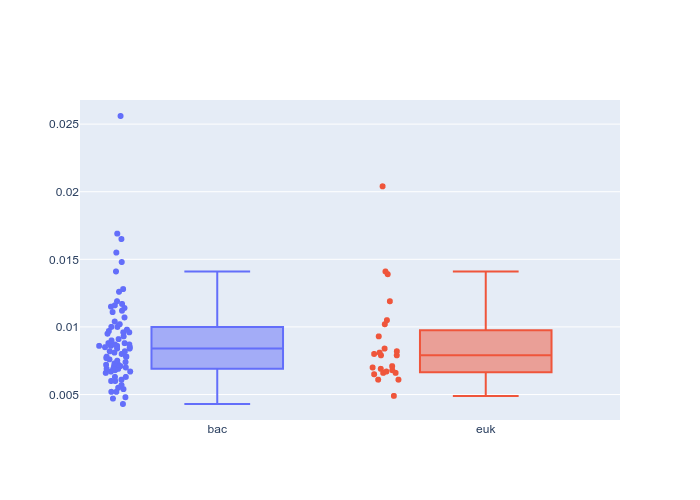

In [808]:
for i in range(1,11):
    bac_names = [f"r_g{i}_n{b.split('n')[-1]}" for b in bac_branch]
    euk_names = [f"r_g{i}_n{b.split('n')[-1]}" for b in euk_branch]
    
    fig = go.Figure()
    fig.add_box(x=['bac']*len(bac_names),
                y=r1.loc[bac_names,'Posterior means'],
                boxpoints='all',text=bac_names,showlegend=False)
    fig.add_box(x=['euk']*len(euk_names),y=r1.loc[euk_names,'Posterior means'],
                boxpoints='all',text=euk_names,showlegend=False)
    fig.layout.height = 500
    fig.layout.width = 700
    img = fig.to_image()
    display(Image(img))
    break

In [ ]:
gene2pvalue = {}
for gene,num_gene in zip(name2s,range(27)):
    rate_df = rates_output['GS2']['p27_B1E1']
    num_gene +=1
    rate_df = rate_df.reindex(index=[_ for _ in rate_df.index if _.startswith(f'r_g{num_gene}_')])
    rate_df.index = [n.replace(f'r_g{num_gene}','t') for n in rate_df.index]
    df1,df2 = rate_df.loc[leaves1,:],rate_df.loc[leaves2,:]
    p = mannwhitneyu(df1["Posterior means"],df2["Posterior means"])
    gene2pvalue[gene] = p.pvalue
    if p.pvalue>=0.05:
        continue
    fig = go.Figure()
    fig.add_box(x=['bac']*df1.shape[0],y=df1.iloc[:,0],boxpoints='all',text=df1.index,showlegend=False)
    fig.add_box(x=['euk']*df2.shape[0],y=df2.iloc[:,0],boxpoints='all',text=df2.index,showlegend=False)
    fig.layout.height = 500
    fig.layout.width = 700
    img = fig.to_image()
    display(Image(img))
    #fig.show()

# topologies

drawing dendrograms
adding color


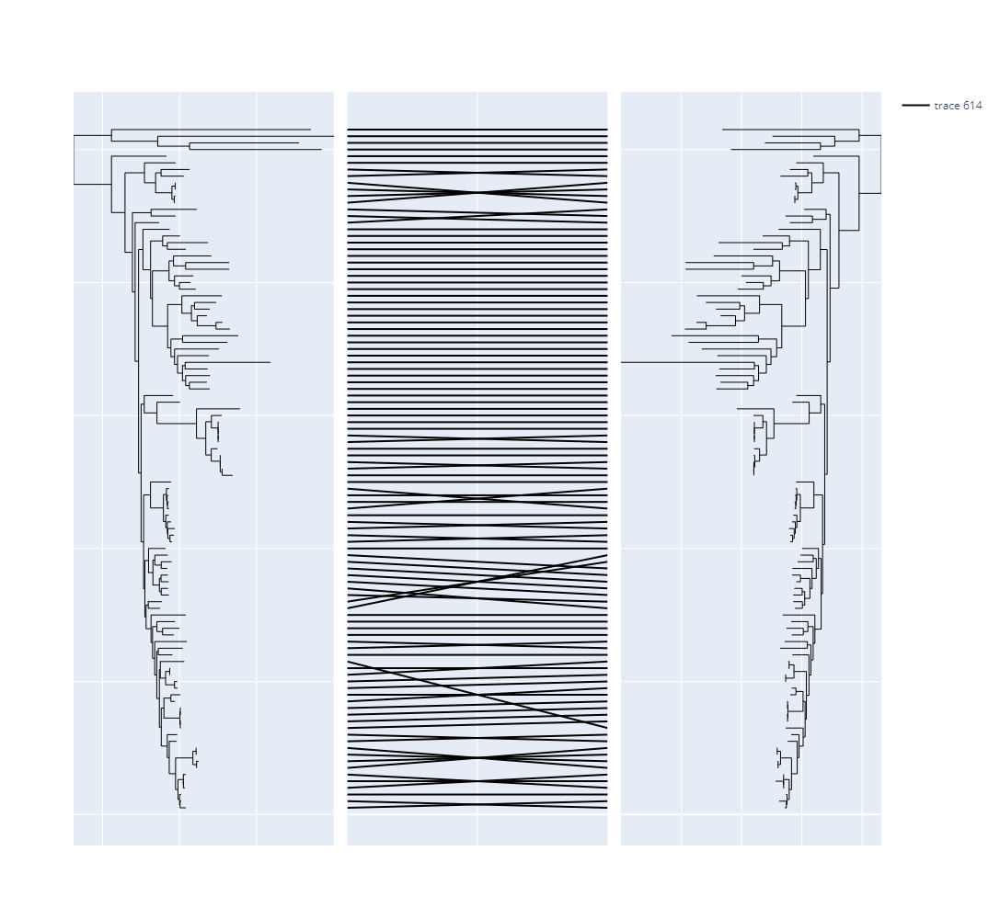

In [689]:
from visualization.tanglegram import tanglegram,cooridinate_two_identical_trees,read_tree
from ete3 import Tree

ref_t = Tree(*topology_dict['GS2TP3'])
gt = Tree(*topology_dict['GS2'])

#n1,n2 = cooridinate_two_identical_trees(ref_t,gt)

fig,left_tre,right_tre = tanglegram(ref_t,gt,identical=True)
fig.layout.height = 1000
fig.layout.width = 600
fig.show()

In [29]:
lt = Tree('/home-backup/thliao/cyano/analysis/nfixer/phylogenomic/iqtree/20220317.newick',3)

In [48]:
def cooridinate_two_identical_trees(newick1,newick2,l2r=None):
    def sort_way(n):
        if n.is_leaf():
            return n.name
        else:
            return ';'.join(n.get_leaf_names())
    t1 = read_tree(newick1)
    t2 = read_tree(newick2)
    for n in t1.traverse('postorder'):
        if not n.is_leaf():
            ls = n.get_leaf_names()
            try:
                n2 = t2.get_common_ancestor([ls[0],ls[-1]])
            except ValueError:
                continue
            if set(n.get_leaf_names()) == set(n2.get_leaf_names()):
                if tuple(n.get_leaf_names()) != tuple(n2.get_leaf_names()):
                    n.children = sorted(n.children,key=lambda x:sort_way(x))
                    n2.children = sorted(n2.children,key=lambda x:sort_way(x))
    return t1,t2

n1,n2 = cooridinate_two_identical_trees(ref_t,gt)

In [36]:
n1,n2 = cooridinate_two_identical_trees(lt,gt)

In [44]:
rf, max_parts, common_attrs, edges1, edges2, discard_t1, discard_t2 = n2.robinson_foulds(n1)

In [ ]:


fig,left_tre,right_tre = tanglegram(n1,n2,identical=True)
fig.layout.height = 1000
fig.layout.width = 600
fig.show()

In [ ]:

ref_t = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/phylogenomic/GS1/GS1_cog59.final.newick',3)
gt = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/phylogenomic/GS1/GS1_cyano59_PMSF.final.newick',3)
#n1,n2 = cooridinate_two_identical_trees(ref_t,gt)
fig,left_tre,right_tre = tanglegram(ref_t,gt,identical=True)
fig.layout.height = 1000
fig.layout.width = 600
fig.layout.yaxis.autorange = 'reversed'
fig.show()

In [ ]:

ref_t = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/phylogenomic/GS1/GS1_cyano59_PMSF.final.newick',3)
gt = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/topology/GS1.newick',3)
#n1,n2 = cooridinate_two_identical_trees(ref_t,gt)
fig,left_tre,right_tre = tanglegram(ref_t,gt,identical=True)
fig.layout.height = 1000
fig.layout.width = 600
fig.layout.yaxis.autorange = 'reversed'
fig.show()

## time tree comparison

Both GS2 P10, one is  B1E4 , and the another is B2E4. difference only at the minimum age of total gorup of cyanobacteria

In [ ]:
a = tree_vis(t2, branch_length=True)
a.get_plotly_data()
a.get_plotly_data??

In [609]:
b = a.idx2clade[0]

In [614]:
a.labels_info

[[-32.373439999999995, 93.4134693145752, 'GCA_001039555.1|GCA_000011385.1'],
 [-30.721539999999994, 87.82693862915039, 'GCA_001039555.1|GCA_000332275.1'],
 [-25.082129999999996, 79.15387725830078, 'GCA_001039555.1|GCA_014696065.1'],
 [-23.832609999999995, 68.05775451660156, 'GCA_001039555.1|GCA_001870225.1'],
 [-23.334378999999995, 51.155548095703125, 'GCA_001039555.1|GCA_002742025.1'],
 [-21.411908999999994, 40.61578369140625, 'GCA_001039555.1|GCA_000478195.2'],
 [-19.478898999999995, 33.1846923828125, 'GCA_001039555.1|GCA_001904725.1'],
 [-17.320738999999996, 27.869384765625, 'GCA_001039555.1|GCA_000473895.1'],
 [-16.680521999999996, 25.73876953125, 'GCA_001039555.1|GCA_000380225.1'],
 [-16.556043999999993, 23.2275390625, 'GCA_001039555.1|GCA_001747005.1'],
 [-6.352543999999995, 20.955078125, 'GCA_001039555.1|GCA_000317575.1'],
 [-5.342483999999995, 17.91015625, 'GCA_001039555.1|GCA_012032735.1'],
 [-4.848352999999996, 14.3203125, 'GCA_001039555.1|GCA_000147335.1'],
 [-4.311697999999

In [626]:
major_lineage2color = {'Total eukaryota': '#4FC3F7',
 'Pseudanabaena': '#7b1fa2',
 'Leptolyngbya': '#ec524f',
 'Phormidium': '#FFE082',
 'Okenia': '#FF80AB',
 'Planktothrix': '#880E4F',
 'Symploca/Moorena': '#FF6F00',
 'UCYN': '#1B5E20',
 'Hydrococcus': '#CCFF90',
 'Nostocales': '#AA00FF',
 'Freshwater Syn': '#00C853',
                       'marine syn/pro':'#00C853'}
n2cc = {}
for k,(name,lca) in key_nodes['GS2'].items():
    if name in major_lineage2color:
        n2cc[k] = major_lineage2color[name]
    #print(name)
# GS2
# n2cc = {'t_n162': '#00C853',
#  't_n145': '#AA00FF',
#  't_n151': '#FF80AB',
#  't_n135': '#CCFF90',
#  't_n120': '#1B5E20',
#  't_n196': '#7b1fa2',
#  't_n161': '#00C853',
#  't_n171': '#4FC3F7'}

In [631]:
    datas1 = tree_vis(t1, branch_length=True).get_plotly_data(yscale=1)
    name2trace = {_["name"]: _ for _ in datas1 if _["name"] is not None}
    for name,trace in name2trace.items():
        n = t1.get_common_ancestor(name.split('|'))
        if n.name in n2cc:
            print(n.name)
            c = n2cc[n.name]
            trace["line"]["color"] = c
            trace["line"]["width"] = 3

t_n120
t_n135
t_n145
t_n151
t_n161
t_n162
t_n171
t_n196


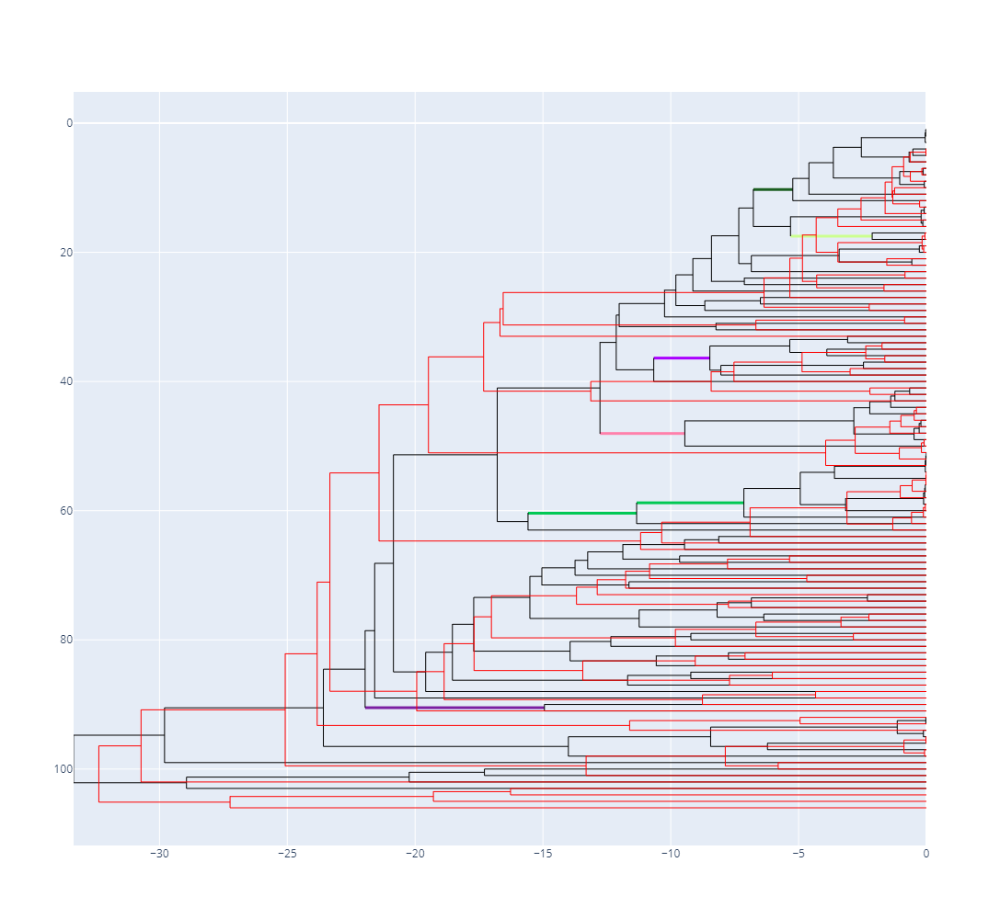

In [634]:
from visualization.tanglegram import tree_vis
t1 = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/mcmc_o/GS2_p10_B1E4_prot/mcmc_for/GS2_p10_B1E4.newick',3)
t2 = Tree('/mnt/home-backup/thliao/cyano/analysis/nfixer/dating/mcmc_o/GS2_p10_B2E4_prot/mcmc_for/GS2_p10_B2E4.newick',3)
#t1_tre = tree_vis(t1, branch_length=True).get_plotly_data(yscale=1)
t2_tre = tree_vis(t2, branch_length=True).get_plotly_data(y_shift=3,color='#ff0000')
fig = go.Figure()
fig.add_traces(datas1)
fig.add_traces(t2_tre)
fig.layout.height = 1000
fig.layout.width = 400
fig.layout.yaxis.autorange='reversed'
fig.show()